# Style Transfer


<img src="https://i0.wp.com/chelseatroy.com/wp-content/uploads/2018/12/neural_style_transfer.png?resize=768%2C311&ssl=1">

La idea de este trabajo final es reproducir el siguiente paper:

https://arxiv.org/pdf/1508.06576.pdf

El objetivo es transferir el estilo de una imagen dada a otra imagen distinta. 

Como hemos visto en clase, las primeras capas de una red convolucional se activan ante la presencia de ciertos patrones vinculados a detalles muy pequeños.

A medida que avanzamos en las distintas capas de una red neuronal convolucional, los filtros se van activando a medida que detectan patrones de formas cada vez mas complejos.

Lo que propone este paper es asignarle a la activación de las primeras capas de una red neuronal convolucional (por ejemplo VGG19) la definición del estilo y a la activación de las últimas capas de la red neuronal convolucional, la definición del contenido.

La idea de este paper es, a partir de dos imágenes (una que aporte el estilo y otra que aporte el contenido) analizar cómo es la activación de las primeras capas para la imagen que aporta el estilo y cómo es la activación de las últimas capas de la red convolucional para la imagen que aporta el contenido. A partir de esto se intentará sintetizar una imagen que active los filtros de las primeras capas que se activaron con la imagen que aporta el estilo y los filtros de las últimas capas que se activaron con la imagen que aporta el contenido.

A este procedimiento se lo denomina neural style transfer.

En este trabajo se deberá leer el paper mencionado y en base a ello, entender la implementación que se muestra a continuación y contestar preguntas sobre la misma.

Una metodología posible es hacer una lectura rápida del paper (aunque esto signifique no entender algunos detalles del mismo) y luego ir analizando el código y respondiendo las preguntas. A medida que se planteen las preguntas, volviendo a leer secciones específicas del paper terminará de entender los detalles que pudieran haber quedado pendientes.

Lo primero que haremos es cargar dos imágenes, una que aporte el estilo y otra que aporte el contenido. A tal fin utilizaremos imágenes disponibles en la web.

In [0]:
# !pip install keras
# pip uninstall keras

In [2]:
# Imagen para estilo
!wget https://upload.wikimedia.org/wikipedia/commons/5/52/La_noche_estrellada1.jpg

# Imagen para contenido
!wget https://upload.wikimedia.org/wikipedia/commons/thumb/f/f4/Neckarfront_T%C3%BCbingen_Mai_2017.jpg/775px-Neckarfront_T%C3%BCbingen_Mai_2017.jpg

# Creamos el directorio para los archivos de salida<
!mkdir /content/output

--2020-04-29 22:57:09--  https://upload.wikimedia.org/wikipedia/commons/5/52/La_noche_estrellada1.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 208.80.154.240, 2620:0:861:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|208.80.154.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 223725 (218K) [image/jpeg]
Saving to: ‘La_noche_estrellada1.jpg’

La_noche_estrellada 100%[===================>] 218.48K   905KB/s    in 0.2s    

2020-04-29 22:57:09 (905 KB/s) - ‘La_noche_estrellada1.jpg’ saved [223725/223725]

--2020-04-29 22:57:13--  https://upload.wikimedia.org/wikipedia/commons/thumb/f/f4/Neckarfront_T%C3%BCbingen_Mai_2017.jpg/775px-Neckarfront_T%C3%BCbingen_Mai_2017.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 208.80.154.240, 2620:0:861:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|208.80.154.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 153015 (149K) [imag

In [3]:
from keras.preprocessing.image import load_img, save_img, img_to_array
import numpy as np
from scipy.optimize import fmin_l_bfgs_b
import time
import argparse

from keras.applications import vgg19
from keras import backend as K
from pathlib import Path 

Using TensorFlow backend.


In [0]:
# Definimos las imagenes que vamos a utilizar, y el directorio de salida
base_image_path = Path("/content/775px-Neckarfront_Tübingen_Mai_2017.jpg")
style_reference_image_path = Path("/content/La_noche_estrellada1.jpg")
result_prefix = Path("/content/output")
iterations = 10

# 1) En base a lo visto en el paper ¿Qué significan los parámetros definidos en la siguiente celda?

Respuesta:


In [0]:
total_variation_weight = 0.1
style_weight = 10
content_weight = 1

**Respuesta "Pregunta 1"** 


Los parámetros se corresponden con los pesos definidos para la LOSS de la Arquitectura de la Red. 

Considerando que la red es capaz de seperar por un lado el Contenido de una imagen, y por otro, su Estilo Gráfico (representación artistica), siendo posible generar y manipular una nueva representación emergente de la combinación de ambas representaciones. Es posible, mediante el ajuste de los pesos de la LOSS, definir la "fuerza" del aporte del contenido (content_weight),o la "fuerza" el aporte del estilo (style_weight) al momento de la reconstrucción de la imagen. El parámetro "total_variation_weight",es un factor de optimización.



In [0]:
# Definimos el tamaño de las imágenes a utilizar
width, height = load_img(base_image_path).size
img_nrows = 400
img_ncols = int(width * img_nrows / height)

# 2) Explicar qué hace la siguiente celda. En especial las últimas dos líneas de la función antes del return. ¿Por qué?

Ayuda: https://keras.io/applications/

Respuesta:

In [0]:
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

**Respuesta "Pregunta 2"**

El objetivo de la función es convertir la representación de una imagen en un Tensor a fin de que el modelo VGG19 pueda realizar su tarea de preprocesamiento mediante pesos pre-entrenados desde la base de datos de ImageNet.

 

*   linea 2: cargo una imagen y defino sus dimensiones de Ancho y Largo
*   Linea 3: transforma la imagen en una Matriz o Array
*   Linea 4: transforma el Array en un Tensor mediante la incorporación de una nueva dimension al Array inicial
*   Linea 5: Se envia la imagen (con estructura de Tensor) al modelo para obtener las caracteristicas de la imagen a nivel de contenido y estilo, tomando los pesos pre-entrenados de la red VGG19.



# 3) Habiendo comprendido lo que hace la celda anterior, explique de manera muy concisa qué hace la siguiente celda. ¿Qué relación tiene con la celda anterior?

In [0]:
def deprocess_image(x):
    x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

**Respuesta "Pregunta 3"**

La función convierte el Tensor en una imagen valida. Convirtiendo la imagen en formato BRG, a RGB. La red VGG, necesita la imagen en formato BRG (cambio en orden de canales) para realizar su tarea de procesamiento. Luego, será necesario volverla a convertir en una imagen en formato RGB para que sea una imagen correctamente visible.


In [0]:
# get tensor representations of our images
# K.variable convierte un numpy array en un tensor, para 
base_image = K.variable(preprocess_image(base_image_path))
style_reference_image = K.variable(preprocess_image(style_reference_image_path))

In [0]:
combination_image = K.placeholder((1, img_nrows, img_ncols, 3))

Aclaración:

La siguiente celda sirve para procesar las tres imagenes (contenido, estilo y salida) en un solo batch.

In [0]:
# combine the 3 images into a single Keras tensor
input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image], axis=0)

In [13]:
# build the VGG19 network with our 3 images as input
# the model will be loaded with pre-trained ImageNet weights
model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

# get the symbolic outputs of each "key" layer (we gave them unique names).
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

80142336/80134624 [==============================] - 2s 0us/step
Model loaded.


# 4) En la siguientes celdas:

- ¿Qué es la matriz de Gram?¿Para qué se usa?
- ¿Por qué se permutan las dimensiones de x?

In [0]:
def gram_matrix(x):
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram

**Respuesta**

La Matriz de Gram es una matriz formada por el producto punto de los pares de columna de una matriz (m-vectors), y se utiliza para determinar la independencia o correlacion lineal de un conjunto de vectores.

La permutación de las dimensiones del tensor de x (imagen),se debe a que es una versión "flatten" de las activaciones multiplicada por ella misma transpuesta.  

Para el caso de Style Transfer se determina que se puede extraer la representación del estilo de los Features Maps (o Activations Maps) mediante el calculo de una Matriz de Gram.  

La matriz de Gram estará formada por los coeficientes de las correlaciones de cada par (i,j), del Feaure Maps vectorizado (F) en la capa de la imagen (N, Feature Responses). De esta manera se captura la tendencia de las caracteriticas a co-ocurrir en distintas partes de la imagen. 

Es decir, el estilo es capturado mediante la identificación de Features especificos, identificando patrones y frecuencias de ocurrencia a lo largo de toda la imagen. Mediante la operación de suma, se descartan redundancias de los patrones identificados.   

$G^l_{ij}= \displaystyle\sum_{K}F^l_{ik}F^l_{jk}$



# 5) Losses:

Explicar qué mide cada una de las losses en las siguientes tres celdas.

Rta:

In [0]:
def style_loss(style, combination):
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return K.sum(K.square(S - C)) / (4.0 * (channels ** 2) * (size ** 2))

**Respuesta Style Loss**

La loss del estilo esta dada por la minimización de la distancia euclediana entre la Matriz de Gram generada en las capas superiores de la CNN de la imagen Original, y la Matriz de Gram generada para una imagen "producida" por el metodo de descenso del gradiente sobre una imagen de ruido blanco (generada aleatoriamente) via backpropagation.  

**Contribución de la capa**  

$ E_l=\frac{1}{4N^2_lM^2_l}\displaystyle\sum_{i,j}(G^l_{i,j}-A^l_{i,j})^2 $


**Loss Total**

$  \ell_{style}(\overrightarrow{a},\overrightarrow{x})=\displaystyle\sum_{l=0}^Lw_lE_l$

$\overrightarrow{a},\overrightarrow{x}$: Imagenes originales

$A^l, G^l$: Imagenes generadas en la capa $\ell$

$w_l$: peso o factor de contribución de la capa $\ell$ a la LOSS

In [0]:
def content_loss(base, combination):
    return K.sum(K.square(combination - base))

**Respuesta Content Loss**

La loss para el contenido esta determinada por el error cuadrado dada entre dos representaciones generadas en una determinada capa.

Si consideramos que en cada capa de la red CNN se encuentra codificada la imagen original en los Features Maps ( manteniendo la relacion espacial con la imagen original ) donde $N_l (filters) = N_l(Feature Maps), $ cada una con dimensión $M_l$ (formado por la multiplicación del Ancho y Largo del Feature Maps).  

La respuesta de la capa $\ell$ es almacenada en una matriz $F \in R^{N_l x M_ l}$ donde $F_{i,j}^l$. 

Mediante el empleo del metodo de Descenso del Gradiente sobre una imagen aleatoria (noise image), se busca generar una imagen que performe similar al Feature Response almacenado en la Matriz $F$

Es decir, si 
$\overrightarrow{p}$ y $\overrightarrow{q}$ son las imagenes originales y $P^l$  y $F^l$ sus respectivas Feature Representations en la capa $l$. Se define la Loss del contenido como el error cuadro medio entre ambas representaciones. 

La loss total por la suma del error cuadrado de cada capa.

$ \ell_{content}(\overrightarrow{p},\overrightarrow{q},l)=\frac{1}{2}\displaystyle\sum_{i,j}(F^l_{i,j}-P^l_{i,j})^2 $






In [0]:
def total_variation_loss(x):
    assert K.ndim(x) == 4
    a = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, 1:, :img_ncols - 1, :])
    b = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, :img_nrows - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))

**Respuesta Total Variation loss**

La variación total esta compuesta por la suma de las losses de las capas de contenido y estilo, multiplicados respectivamente por sus coeficientes $\alpha$ y $\beta$.

$\mathcal L_{total}(\overrightarrow{p},\overrightarrow{a},\overrightarrow{x})=\alpha \mathcal L_{content}(\overrightarrow{p},\overrightarrow{p}) + \beta \mathcal L_{style}(\overrightarrow{a},\overrightarrow{x})  $

El factor $\alpha$ es el coeficiente de contenido y el $\beta$ el coeficiente del estilo, donde $w_l$ esta dada por $1/N$ (donde $N$ se corresponden con las capas activas con loss cuyo coeficiente o $w_l$ no sea 0).

Se utiliza para controlar el balance entre las losses del contenido y el estilo a la salida (output) para el computo de la Imagen Mezclada en la salida final, obteniendo de esta manera imagenes mas parecidas al Estilo o mas parecida el Contenido según un peso definido.





In [0]:
# Armamos la loss total
loss = K.variable(0.0)
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = loss + content_weight * content_loss(base_image_features,
                                            combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']
                  
for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :] 
    combination_features = layer_features[2, :, :, :]
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(feature_layers)) * sl
loss = loss + total_variation_weight * total_variation_loss(combination_image)

In [0]:
grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
    outputs += grads
else:
    outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

# 6) Explique el propósito de las siguientes tres celdas. ¿Qué hace la función fmin_l_bfgs_b? ¿En qué se diferencia con la implementación del paper? ¿Se puede utilizar alguna alternativa?

Respuesta:

In [0]:
def eval_loss_and_grads(x):
    x = x.reshape((1, img_nrows, img_ncols, 3))
    outs = f_outputs([x])
    loss_value = outs[0]
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    return loss_value, grad_values

# this Evaluator class makes it possible
# to compute loss and gradients in one pass
# while retrieving them via two separate functions,
# "loss" and "grads". This is done because scipy.optimize
# requires separate functions for loss and gradients,
# but computing them separately would be inefficient.

In [0]:
class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

# 7) Ejecute la siguiente celda y observe las imágenes de salida en cada iteración.

In [23]:
evaluator = Evaluator()

# run scipy-based optimization (L-BFGS) over the pixels of the generated image
# so as to minimize the neural style loss
x = preprocess_image(base_image_path)

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    fname = result_prefix / ('output_at_iteration_%d.jpeg' % i)
    save_img(fname, img)
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0
Current loss value: 13274708000.0
Image saved as /content/output/output_at_iteration_0.jpeg
Iteration 0 completed in 15s
Start of iteration 1
Current loss value: 6282185700.0
Image saved as /content/output/output_at_iteration_1.jpeg
Iteration 1 completed in 7s
Start of iteration 2
Current loss value: 4240954000.0
Image saved as /content/output/output_at_iteration_2.jpeg
Iteration 2 completed in 7s
Start of iteration 3
Current loss value: 3235871200.0
Image saved as /content/output/output_at_iteration_3.jpeg
Iteration 3 completed in 7s
Start of iteration 4
Current loss value: 2663188000.0
Image saved as /content/output/output_at_iteration_4.jpeg
Iteration 4 completed in 7s
Start of iteration 5
Current loss value: 2338953700.0
Image saved as /content/output/output_at_iteration_5.jpeg
Iteration 5 completed in 7s
Start of iteration 6
Current loss value: 2084144600.0
Image saved as /content/output/output_at_iteration_6.jpeg
Iteration 6 completed in 7s
Start of iteration

**Respuesta de Pregunta 6**

El sentido de las últimas 3 celdas es el de optimizar el procesamiento del modelo, para ello la función **fmin_l_bfgs_b** del paquete scipy necesita la **loss** y el **gradiente** como input. Para mejorar su eficiencia, ambas se calculan al mismo tiempo, y no por separado.

Para eso la función **eval_loss_and_grads** captura los datos del gradiente y la loss, y luego la función **Evaluator**, crea una clase que utiliza que llama a dicha función en cada iteración que se defina como parámetro.

El paper, utiliza el metodo de **Gradient Descent** para generar una imagen sobre una imagen ruido (noise image).

Pueden emplearse otros metodos de optimización como por ejemplo **Adam**, **Adagrad** o **RMSprop**.

In [0]:
from PIL import Image
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

cant_img_to_show = 12
img_files = []
img_titles = []
file_name = 'output/output_at_iteration_'
ext_img = '.jpeg'

steps = round(iterations / cant_img_to_show)

for i in range(0,iterations,steps):
    f = f'{file_name}{i}{ext_img}'
    t = f'iteration {i}'
    img_files.append(f)
    img_titles.append(t)

**A continuación se visualizan las imagenes planteadas en la pregunta 7**

IndexError: ignored

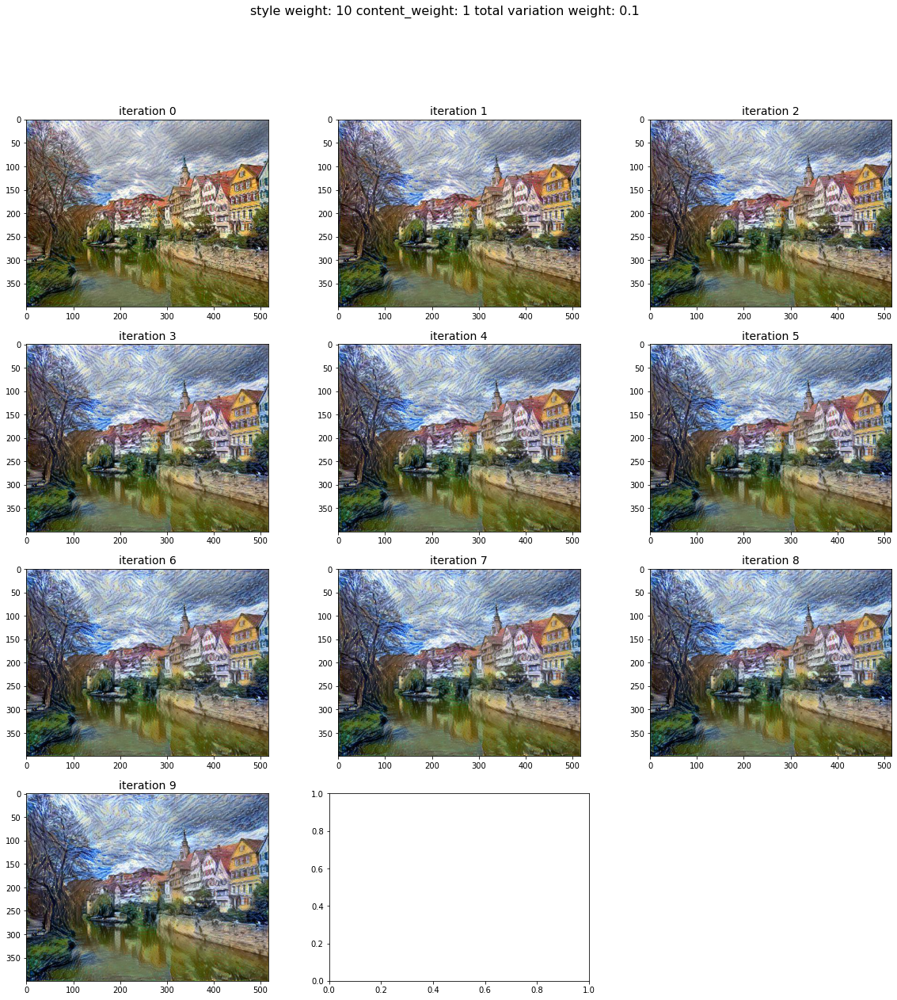

In [26]:
# Plot outpus

fig = plt.figure(figsize=(20,20))
fig.suptitle(f'style weight: {style_weight} content_weight: {content_weight} total variation weight: {total_variation_weight}', fontsize=16)

cols = 3
rows = round(cant_img_to_show/cols)

for i in range(cant_img_to_show):
  x = fig.add_subplot(rows,cols,i+1)
  img = mpimg.imread(img_files[i])
  imgplot = plt.imshow(img)
  x.set_title(img_titles[i],fontdict={'fontsize':'14'})

# 8) Generar imágenes para distintas combinaciones de pesos de las losses. Explicar las diferencias. (Adjuntar las imágenes generadas como archivos separados.)

Respuesta:



# Generación de nuevos pesos

In [0]:
# # nueva carpeta donde se almacenan otros resultados
import os
new_folder = 'new_output'
os.mkdir(f'/content/{new_folder}')
folder_to_save = f'/content/{new_folder}'

**Se arman distintas combinaciones de pesos y se guarda cada imagen con el nombre de los pesos probados**

In [29]:
# armo arrays con variaciones de pasos que deseo probar
tv_w = [1,1,1,1,1]
s_w = [1,.1e-5,10,10,1]
c_w = [10,10,1e-10,.1,1]

#defino nueva cantidad de iteraciones
new_iterations = 10

new_outputs_titles = []
new_outputs_files = []

for t,s,c in zip(tv_w,s_w,c_w):
  
  total_variation_weight = t
  style_weight = s
  content_weight = c
  
  model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
  print('Model loaded.')

  # get the symbolic outputs of each "key" layer (we gave them unique names).
  outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

  # Armamos la loss total
  loss = K.variable(0.0)
  layer_features = outputs_dict['block5_conv2']
  base_image_features = layer_features[0, :, :, :]
  combination_features = layer_features[2, :, :, :]
  loss = loss + content_weight * content_loss(base_image_features,
                                              combination_features)

  feature_layers = ['block1_conv1', 'block2_conv1',
                    'block3_conv1', 'block4_conv1',
                    'block5_conv1']
                    
  for layer_name in feature_layers:
      layer_features = outputs_dict[layer_name]
      style_reference_features = layer_features[1, :, :, :] 
      combination_features = layer_features[2, :, :, :]
      sl = style_loss(style_reference_features, combination_features)
      loss = loss + (style_weight / len(feature_layers)) * sl
  loss = loss + total_variation_weight * total_variation_loss(combination_image)

  grads = K.gradients(loss, combination_image)

  outputs = [loss]
  if isinstance(grads, (list, tuple)):
      outputs += grads
  else:
      outputs.append(grads)

  f_outputs = K.function([combination_image], outputs)

  evaluator = Evaluator()

  x = preprocess_image(base_image_path)

  for i in range(new_iterations):
      print('Start of iteration', i)
      start_time = time.time()
      x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                      fprime=evaluator.grads, maxfun=20)
      print('Current loss value:', min_val)
      # save current generated image
      img = deprocess_image(x.copy())
      fname = f'{folder_to_save}/{i}_iter__tv_{total_variation_weight}_sw_{style_weight}_cw_{content_weight}.jpeg'
      # Completo los nuevos arrays
      title = f'{i}_iter_tv_{total_variation_weight}_sw_{style_weight}_cw_{content_weight}'
      files = f'{new_folder}/{title}.jpeg'
      new_outputs_titles.append(title)
      new_outputs_files.append(files)

      save_img(fname, img)
      end_time = time.time()
      print('Image saved as', fname)
      print('Iteration %d completed in %ds' % (i, end_time - start_time))

Model loaded.
Start of iteration 0
Current loss value: 7306668000.0
Image saved as /content/new_output/0_iter__tv_1_sw_1_cw_10.jpeg
Iteration 0 completed in 7s
Start of iteration 1
Current loss value: 5081823000.0
Image saved as /content/new_output/1_iter__tv_1_sw_1_cw_10.jpeg
Iteration 1 completed in 7s
Start of iteration 2
Current loss value: 4391039000.0
Image saved as /content/new_output/2_iter__tv_1_sw_1_cw_10.jpeg
Iteration 2 completed in 7s
Start of iteration 3
Current loss value: 4050781000.0
Image saved as /content/new_output/3_iter__tv_1_sw_1_cw_10.jpeg
Iteration 3 completed in 7s
Start of iteration 4
Current loss value: 3841767400.0
Image saved as /content/new_output/4_iter__tv_1_sw_1_cw_10.jpeg
Iteration 4 completed in 7s
Start of iteration 5
Current loss value: 3690736000.0
Image saved as /content/new_output/5_iter__tv_1_sw_1_cw_10.jpeg
Iteration 5 completed in 7s
Start of iteration 6
Current loss value: 3578503200.0
Image saved as /content/new_output/6_iter__tv_1_sw_1_cw_

# Plot con nuevos pesos

In [0]:
import os
n_f = []
for file in os.listdir(folder_to_save):
    if file.endswith(".jpeg"):
        name = os.path.join(folder_to_save, file)
        n_f.append(name)

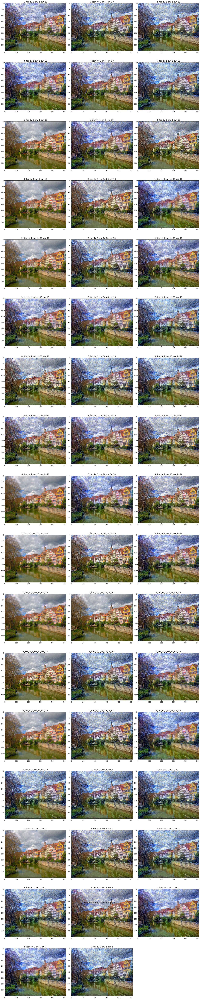

In [32]:
# plot nuevas imagenes
fig = plt.figure(figsize=(20,100))
fig.suptitle(f'Imagenes con distintos pesos', fontsize=16, y=0.1)
# fig.tight_layout()

cols = 3
rows = round(len(n_f)/cols) # la cantidad va a estar determinada por la cantidad de valores a probar

for i in range(len(n_f)):
  x = fig.add_subplot(rows,cols,i+1)
  img = mpimg.imread(n_f[i])
  imgplot = plt.imshow(img)
  x.set_title(new_outputs_titles[i],fontdict={'fontsize':'14'})

fig.tight_layout()

# 9) Cambiar las imágenes de contenido y estilo por unas elegidas por usted. Adjuntar el resultado.

In [0]:
!mkdir /content/own_output
base_image_path = Path("/content/img1.jpg")
style_reference_image_path = Path("/content/manet.jpg")
result_prefix = Path("/content/own_output")

width, height = load_img(base_image_path).size
img_nrows = 400
img_ncols = int(width * img_nrows / height)

base_image = K.variable(preprocess_image(base_image_path))
style_reference_image = K.variable(preprocess_image(style_reference_image_path))

combination_image = K.placeholder((1, img_nrows, img_ncols, 3))

input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image], axis=0)

In [35]:
#defino nueva cantidad de iteraciones
new_iterations = 10

total_variation_weight = 10
style_weight = 20
content_weight = .1

model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

# get the symbolic outputs of each "key" layer (we gave them unique names).
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

Model loaded.


In [0]:
# Armamos la loss total
loss = K.variable(0.0)
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = loss + content_weight * content_loss(base_image_features,
                                            combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']
                  
for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :] 
    combination_features = layer_features[2, :, :, :]
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(feature_layers)) * sl
loss = loss + total_variation_weight * total_variation_loss(combination_image)

In [0]:
grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
    outputs += grads
else:
    outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

In [38]:
evaluator = Evaluator()

# run scipy-based optimization (L-BFGS) over the pixels of the generated image
# so as to minimize the neural style loss
x = preprocess_image(base_image_path)

for i in range(new_iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    fname = result_prefix / ('output_at_iteration_%d.jpeg' % i)
    save_img(fname, img)
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0
Current loss value: 35064193000.0
Image saved as /content/own_output/output_at_iteration_0.jpeg
Iteration 0 completed in 9s
Start of iteration 1
Current loss value: 24758495000.0
Image saved as /content/own_output/output_at_iteration_1.jpeg
Iteration 1 completed in 7s
Start of iteration 2
Current loss value: 21966555000.0
Image saved as /content/own_output/output_at_iteration_2.jpeg
Iteration 2 completed in 7s
Start of iteration 3
Current loss value: 20868657000.0
Image saved as /content/own_output/output_at_iteration_3.jpeg
Iteration 3 completed in 7s
Start of iteration 4
Current loss value: 20060766000.0
Image saved as /content/own_output/output_at_iteration_4.jpeg
Iteration 4 completed in 7s
Start of iteration 5
Current loss value: 19469273000.0
Image saved as /content/own_output/output_at_iteration_5.jpeg
Iteration 5 completed in 7s
Start of iteration 6
Current loss value: 18991751000.0
Image saved as /content/own_output/output_at_iteration_6.jpeg
Iteration 6 c

**Plot con imagenes propias**

Text(0.5, 1.0, 'Imagen de Estilo')

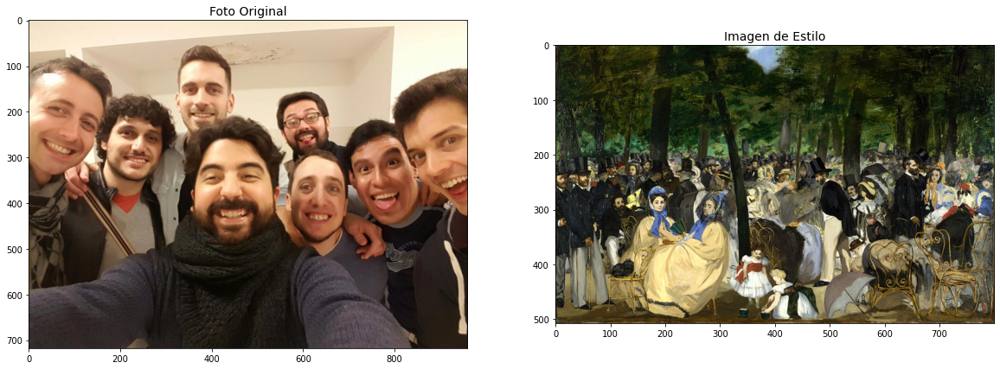

In [58]:
img_foto = 'img1.jpg'
img_style = 'manet.jpg'

fig = plt.figure(figsize=(20,20))

x = fig.add_subplot(1,2,1)
img = mpimg.imread(img_foto)
imgplot = plt.imshow(img)
x.set_title('Foto Original',fontdict={'fontsize':'14'})

x = fig.add_subplot(1,2,2)
img2 = mpimg.imread(img_style)
imgplot = plt.imshow(img2)
x.set_title('Imagen de Estilo',fontdict={'fontsize':'14'})


**Resultado Final - Ultima Iteracion**

Text(0.5, 1.0, 'Resultado FInal')

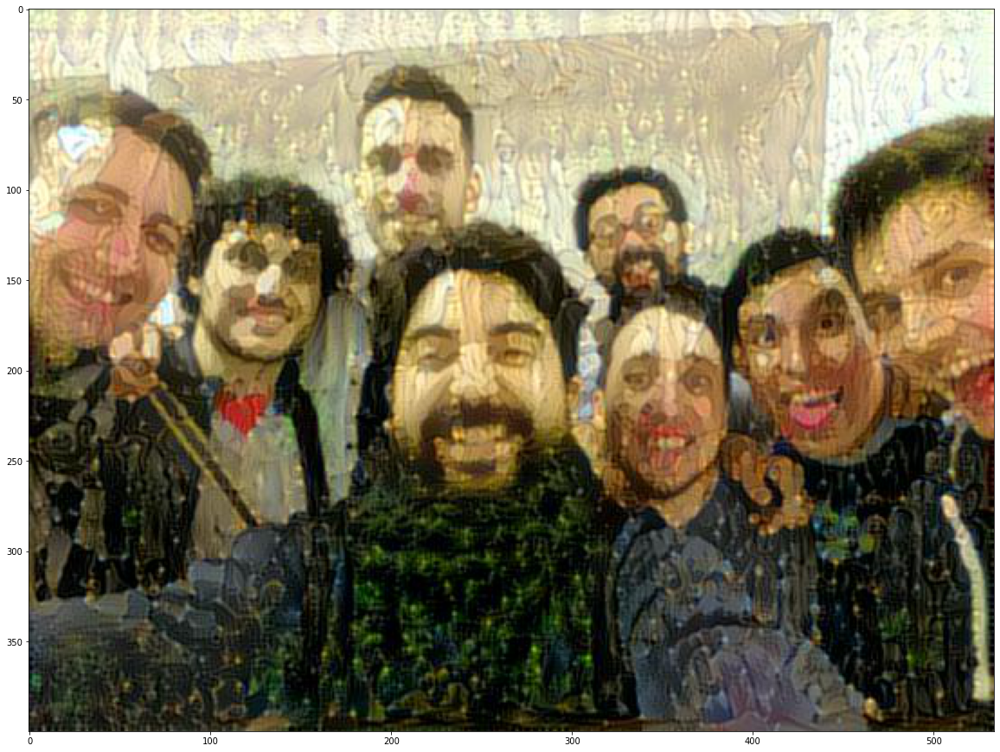

In [61]:
fig = plt.figure(figsize=(20,20))
img_own_output = 'own_output/output_at_iteration_9.jpeg'
img = mpimg.imread(img_own_output)
imgplot = plt.imshow(img)
x.set_title('Resultado FInal',fontdict={'fontsize':'14'})